# 429904 m3 stage 2 day 1 no spouts - WT

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

An explanation of each of the functions is in the preprocessing script

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs #plotly #need to do this through conda install

'install the packages to run this code'

## Step 1: importing the proper libraries

please note these are all compatible with Python 3.12 as of 2023, Dec, 07

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure
)

## Step 2: manual input to the script

Please insert the file path for the tif stack as a 3d array, as well as the frame you would like to look at as an example frame

In [3]:
video = "X://Raymond Lab//Kaiiiii//cortical_data//Pilot//spouts//429904_m3_stage2_day1_no_spouts.tif"
frame_number = 6000

In [4]:
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...
dimensions are (34994, 128, 128) as a uint16


## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


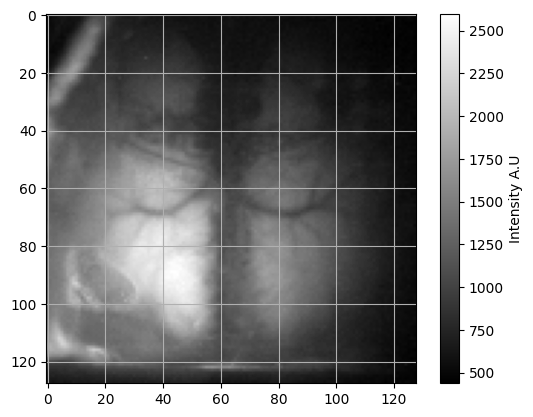

frame number 6000 plotted


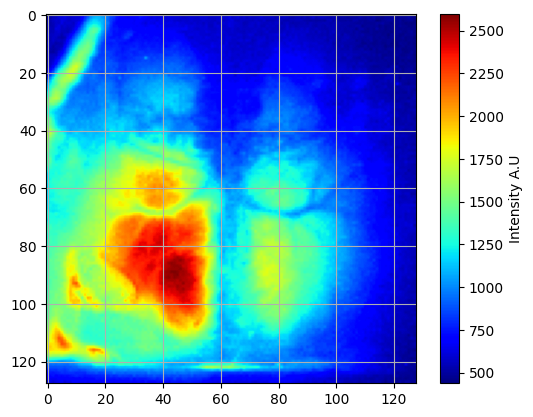

In [5]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

default 20% threshold is 453.3957275390625 Determine if adjustments need to be made


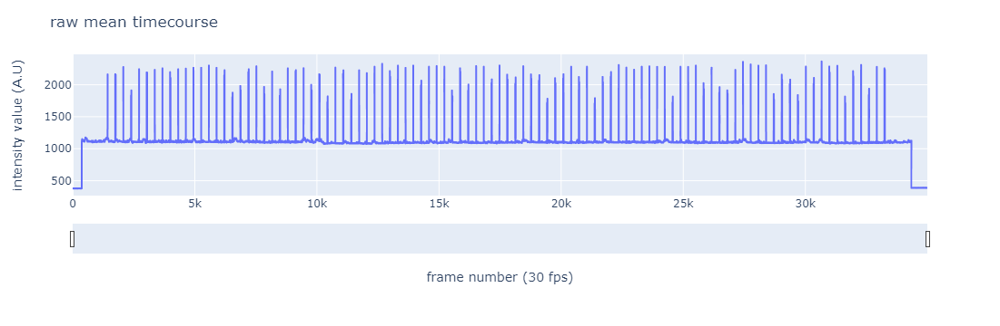

In [6]:
mean_timecourse = temporal_mean(frames);

## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

threshold determined to be: 510.0701934814453


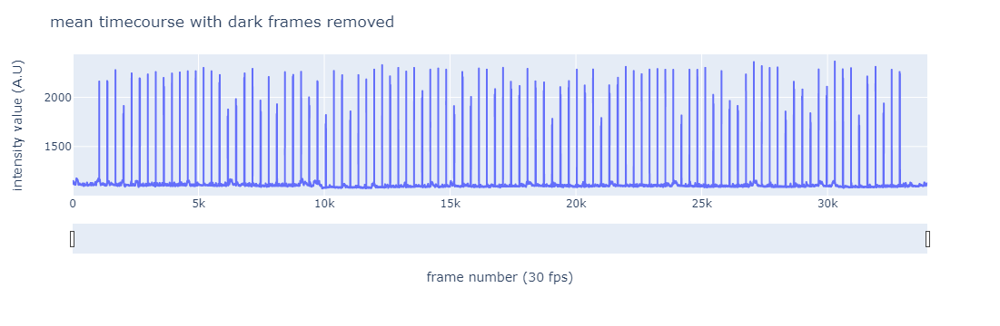

In [7]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

!! If the total does not match the single and double combined, check dataset!!

In [8]:
artifacts = extract_artifacts(darkf_removed_timecourse)
artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 94
Number of double_flash pairs: 47
Number of single_flash: 53
Number of total flashes: 147


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

interpolating artifact frames...


100%|████████████████████████████████████████████████████████████████████████████████| 147/147 [03:19<00:00,  1.36s/it]


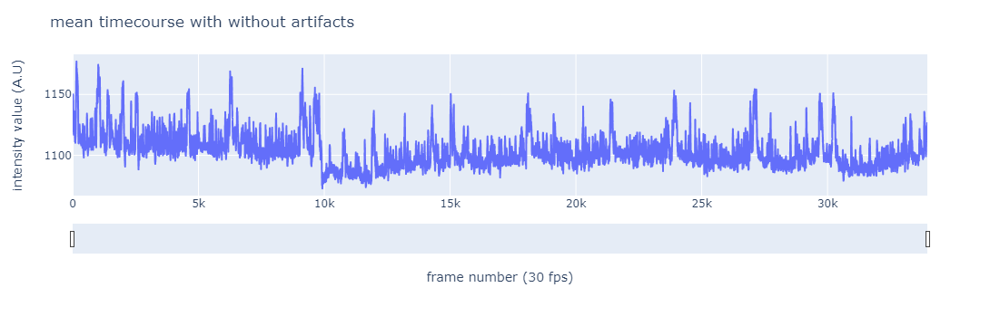

In [9]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 3)

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [10]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

100%|███████████████████████████████████████████████████████████████████████████| 33967/33967 [02:12<00:00, 255.52it/s]


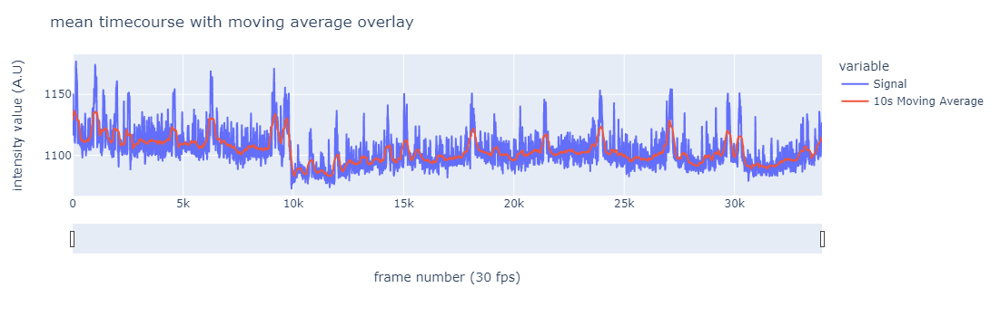

In [11]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

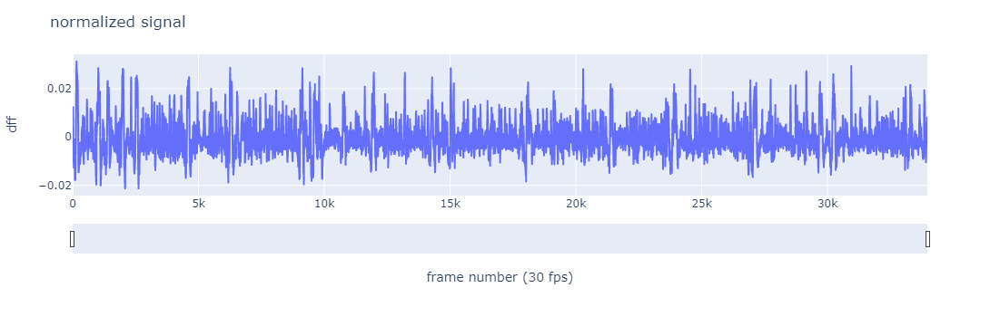

In [12]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


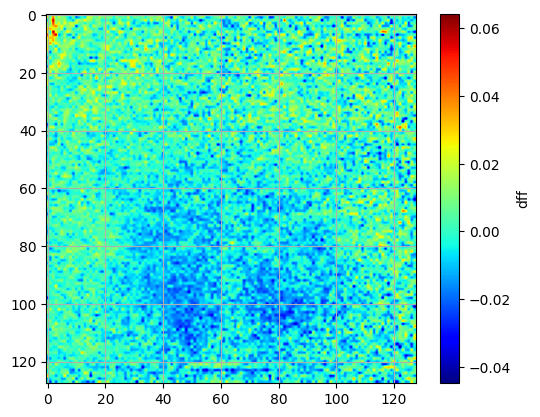

In [13]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:44<00:00,  2.87it/s]


frame number 200 plotted


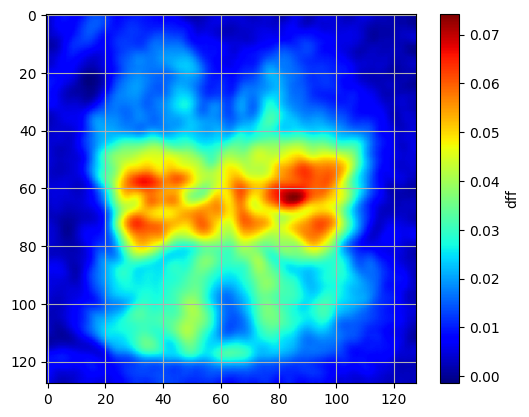

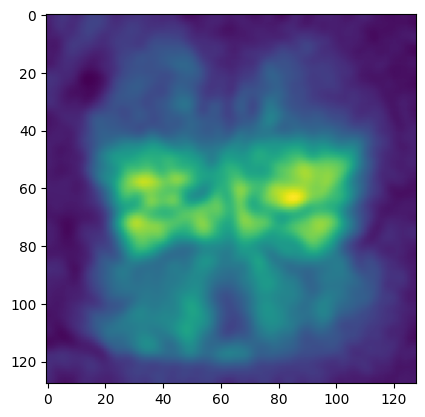

In [14]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

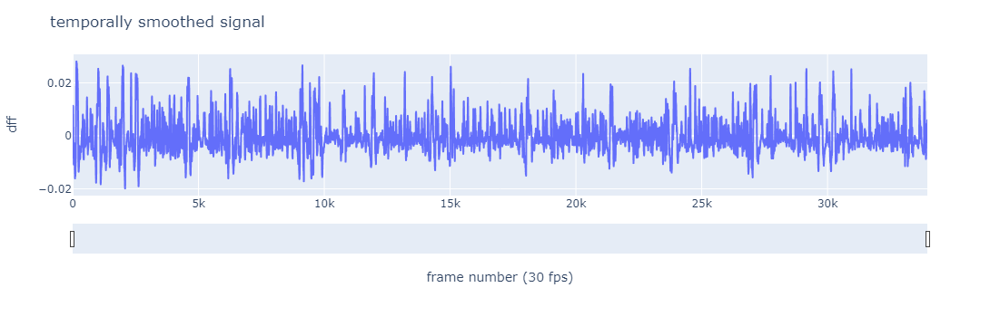

In [15]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [16]:
full_roi_single = avg_trials(single_indices, smoothed_signal, 'FALSE', 330)

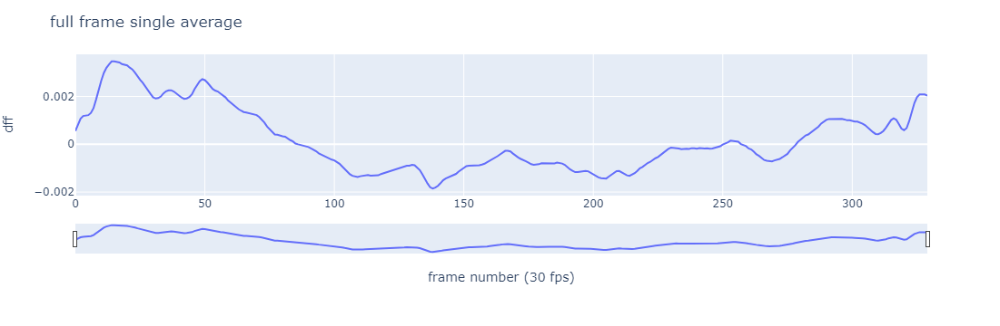

In [17]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [18]:
full_roi_double = avg_trials(double_indices, smoothed_signal, 'TRUE', 330)

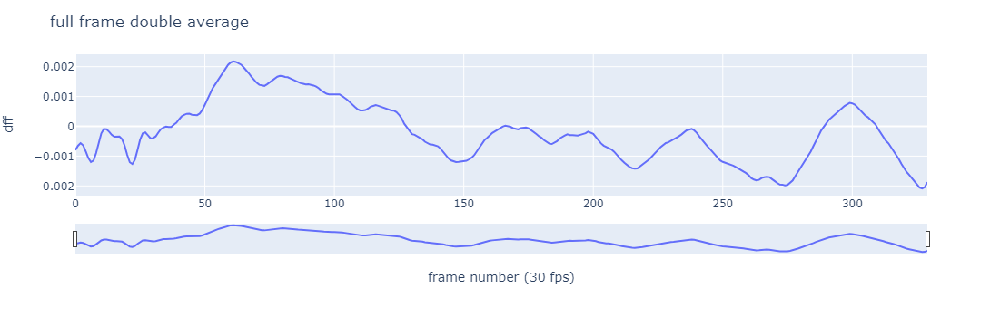

In [19]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [20]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

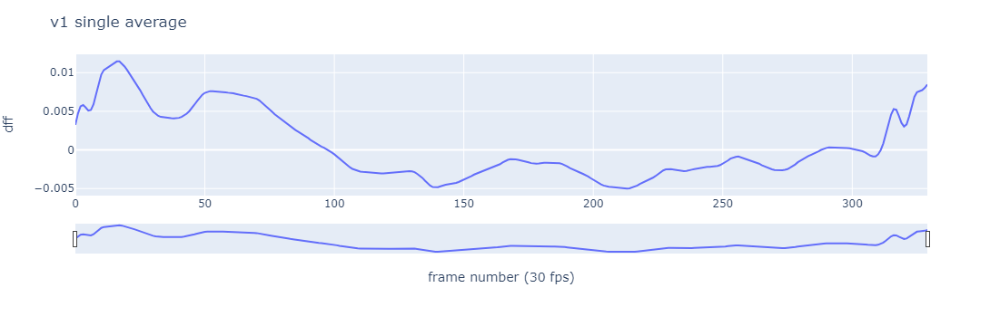

In [21]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [22]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

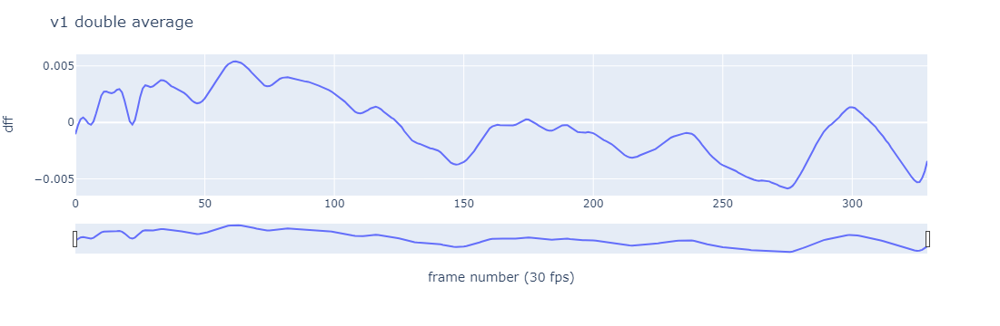

In [23]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Save the 3D array as a TIFF stack

!!! Be sure to write in the file path to where you would like the processed tiff stack stored !!!

In [24]:
masking = load_masks(dff_signal)
mask, mask_outline = masking[0], masking[1]

masked_smoothed_signal = smoothed_signal*mask
masked_full_roi_single = full_roi_single*mask
masked_full_roi_double = full_roi_double*mask

In [25]:
file_path = "X:/Raymond Lab/Kaiiiii/processed_data/429904_m3_stage2_day1_no_spouts.tiff" 
save_tiff(smoothed_signal, file_path)

file_path = "X:/Raymond Lab/Kaiiiii/processed_data/429904_m3_stage2_day1_no_spouts_avg_single.tiff" 
save_tiff(mean_single, file_path)

file_path = "X:/Raymond Lab/Kaiiiii/processed_data/429904_m3_stage2_day1_no_spouts_avg_double.tiff" 
save_tiff(mean_double, file_path)

print(f"TIFF stack saved at: {file_path}")

100%|█████████████████████████████████████████████████████████████████████████| 33967/33967 [00:01<00:00, 25318.04it/s]


Combined TIFF stack saved successfully.


NameError: name 'mean_single' is not defined

In [ ]:
#animate_figure(v1_area_single, fps=10, save_path="X:/Raymond Lab/Kaiiiii/processed_data/429904_m1/videos_with_signal/429904_m1_day2_with_spout_avg_single_graph.gif")
animate_figure(v1_area_single, fps=10, save_path="C:/Users/trapped/Documents/GitHub/corticalanalysis/Notebook/animated_graphs/429904_m3_day1_no_spouts_avg_single_graph.gif")

## Step 9: txt files with timestamps of flash location

In [ ]:
#txt_file_path = "please insert file path to txt file" #r"X:\Raymond Lab\Kaiiiii\pi_data\2023_dec_two_lights\413590_m7_stage2_two_lights_2023-12-20_21-04-53_data.txt"

Extracting the indices where the flashes exist

In [ ]:
#txt_data = load_txt(txt_file_path, 30, 4);
#txt_flashes, txt_file, flash_type= txt_data[0], txt_data[1], txt_data[2]

Creating separate arrays for single and double flashes, and checking consistency between artifacts and the txt file

In [ ]:
#allflashes =  extract_txt_flashes(txt_flashes, flash_type, 30, 0.5);
#both_flashes, single_txt, double_txt = allflashes[0], allflashes[1], allflashes[2]

#flash_check = artifact_indices-both_flashes

#print("difference between txt file flash location and artifact location:", flash_check)

## beta testing Step 10: spatial filtering

In [ ]:
masking = load_masks(dff_signal)
mask, mask_outline = masking[0], masking[1]

In [ ]:
frame_num = 3000 #set this myself
img = dff_signal[frame_num]  #frame I am using to compare
plot_frame(frames, frame_num, cmap = 'grey', color_label = "Intensity A.U")  #plot raw signal

#### 1. regular gaussian smoothing

In [ ]:
#regular way of smoothing
regular = smoothed_signal * mask

In [ ]:
print("plotting regular")
r_im = plt.imshow(regular[frame_num])
plt.colorbar(r_im)
save_tiff(regular,  "X:/Raymond Lab/Kaiiiii/processed_data/dff_regular.tiff")

#### 2. steve method: I take out the area of interest and only apply the spatial smoothing on that and them add it back to the image

In [ ]:
def steve_method(array3d, blur, mask_outline):
    
    invmask = np.logical_not(mask_outline)

    masked = array3d * mask_outline
    remaining = array3d * invmask

    blurred = gaussian_filter(masked, sigma = blur) #the suggested smoothing, only difference is sigma and radius
    
    blurred = blurred+remaining
    return blurred

In [ ]:
steve = steve_method(dff_signal, 3, mask_outline)

In [ ]:
print("plotting steve method")
steve *= mask
s_im = plt.imshow(steve[frame_num])
plt.colorbar(s_im)
save_tiff(steve,  "X:/Raymond Lab/Kaiiiii/processed_data/dff_steve.tiff")

#### 3. dilate method: using grey_dilation from scipy

In [ ]:
def dilate_method(array3d, blur, mask_outline): #havent been able to get this to work on a 3d stack yet
    invmask = np.logical_not(mask_outline).astype(int)    
    masked = array3d * mask_outline
    masked2 = scipy.ndimage.grey_dilation(masked,size=(5,5))
    masked2 = masked2 *mask_outline
    masked2 = masked + masked2
    blurred2 = scipy.ndimage.gaussian_filter(masked2, sigma = blur)
    return blurred2

In [ ]:
dilate = dilate_method(img, 3, mask_outline)

In [ ]:
print("plotting dilate method")
dilate *= mask
d_im = plt.imshow(dilate)
plt.colorbar(d_im)

#### 4. normalized convoulution

In [ ]:
def norm_conv(array3d, blur, mask_outline):
    mask_float = mask_outline.astype(float)
    norm_conv = []
    for frame in tqdm(array3d):
        filter = gaussian_filter(frame * mask_outline, sigma = blur)
        weights = gaussian_filter(mask_outline, sigma = blur)
        norm_conv.append(filter/weights)

    return norm_conv

In [ ]:
norm_conv = norm_conv(dff_signal, 3, mask_outline)

In [ ]:
print("plotting normalized convoulation")
norm_conv *= mask
n_im = plt.imshow(norm_conv[frame_num])
plt.colorbar(n_im)
save_tiff(filter,  "X:/Raymond Lab/Kaiiiii/processed_data/dff_norm_conv.tiff")

#### 5. bilateral filter based denoising

In [ ]:
bilateral = []
for img_frame in tqdm(dff_signal):
    bilateral.append(cv2.bilateralFilter(img_frame, 9, 10, 10)) #first value is d, second and third are sigma
bilateral_array = np.array(bilateral)

In [ ]:
#print("plotting bilateral filtering")
bilateral_array *= mask
b_im = plt.imshow(bilateral_array[frame_num])
plt.colorbar(d_im)
save_tiff(bilateral_array,  "X:/Raymond Lab/Kaiiiii/processed_data/dff_bilateral.tiff")